In [3]:
from print_versions import print_versions

#import os, re, gc
import numpy as np
#import pandas as pd
#import matplotlib.pyplot as plt
#from matplotlib import rcParams
#import seaborn as sn
#import anndata
import scanpy as sc
import scvelo as scv
#import sctk as sk
#import cellrank as cr

#rcParams['pdf.fonttype'] = 42
#rcParams['ps.fonttype'] = 42
#expr_cmap = sk.expression_colormap()
#np.set_printoptions(linewidth=150)

In [4]:
print_versions(globals())

numpy==1.23.5
scanpy==1.9.6
scvelo==0.3.2


In [2]:
# Load recomputed UMAPs on filtered cell types
adata_ori = sc.read("../data/rna/scRNA_batch1_2.processed.fibroblasts.h5ad")

Only considering the two last: ['.fibroblasts', '.h5ad'].
Only considering the two last: ['.fibroblasts', '.h5ad'].


In [3]:
#adata_ori.obs

In [4]:
adata_ori

AnnData object with n_obs × n_vars = 26727 × 17590
    obs: 'doublet_bh_pval', 'n_counts', 'sample_id', 'scrublet_score', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'percent_top50', 'GEX_SID', 'ATAC_SID', 'GEX', 'ATAC', 'Sample', 'DOB', 'Gender', 'date', 'age_years', 'state', 'disease', 'site_taken_fine', 'site_taken_broad', 'sorted', 'Nancy_histologic_score', 'slide_look_other', 'whole_tissue_signature', 'scSeq', 'bulkSeq', 'annot_batch1_lr', 'annot_batch1_lr_prob', 'annot_batch2_lr', 'annot_batch2_lr_prob', 'leiden_bk_r0_1', 'leiden_bk_r0_3', 'leiden_bk_r0_5', 'is_doublet', 'leiden_bk_split1', 'leiden_bk_split2', 'leiden_bk_split3', 'annot1', 'leiden_bk_split4', 'annot_gut_lr', 'annot_gut_lr_prob', 'broad_annot1'
    var: 'gene_ids', 'mito', 'ribo', 'hb', 'n_counts', 'n_cells', 'cc', 'highly_variable', 'highly_variable_nbatches', 'hvg_full'
    uns: 'annot1_colors', 'leiden', 'neighbors', 'neighbors_bk', 'pca', 'umap'
    obsm: 'X_pca'

In [5]:
# Load raw, unfiltered data with layers for spliced and unspliced transcripts
adata = sc.read('velocyto_filtered.raw.h5ad')

In [6]:
adata

AnnData object with n_obs × n_vars = 38116 × 33538
    obs: 'n_counts_s', 'n_counts_u', 'n_counts_a', 'n_counts', 'sample_id', 'Sample', 'DOB', 'Gender', 'date', 'age_years', 'state', 'disease', 'site_taken_fine', 'site_taken_broad', 'sorted', 'Nancy_histologic_score', 'slide_look_other', 'whole_tissue_signature', 'doublet_bh_pval', 'scrublet_score', 'is_doublet', 'annot1', 'broad_annot1', 'annot_gut_lr', 'annot_gut_lr_prob'
    var: 'gene_ids'
    obsm: 'X_umap'
    layers: 'ambiguous', 'spliced', 'unspliced'

In [7]:
adata.obs.annot1.value_counts()

annot1
S3                         8295
S1                         5644
VE postcapillary venlue    4171
VE arterial tip            3218
S3x                        3175
S5                         3103
S2                         3029
LE                         1757
MF1                        1401
PC                         1200
GL                          971
VE capillary                856
S4                          699
VE arterial                 256
MF2                         181
IM                          160
Name: count, dtype: int64

In [8]:
adata

AnnData object with n_obs × n_vars = 38116 × 33538
    obs: 'n_counts_s', 'n_counts_u', 'n_counts_a', 'n_counts', 'sample_id', 'Sample', 'DOB', 'Gender', 'date', 'age_years', 'state', 'disease', 'site_taken_fine', 'site_taken_broad', 'sorted', 'Nancy_histologic_score', 'slide_look_other', 'whole_tissue_signature', 'doublet_bh_pval', 'scrublet_score', 'is_doublet', 'annot1', 'broad_annot1', 'annot_gut_lr', 'annot_gut_lr_prob'
    var: 'gene_ids'
    obsm: 'X_umap'
    layers: 'ambiguous', 'spliced', 'unspliced'

## Subset data

In [9]:
adata = adata[adata.obs.index.isin(adata_ori.obs.index)]

In [10]:
adata.obs.annot1.cat.categories

Index(['S3', 'S1', 'S3x', 'S5', 'S2', 'MF1', 'MF2', 'PC', 'S4'], dtype='object')

In [11]:
adata.obs.annot1 = adata.obs.annot1.cat.reorder_categories(adata_ori.obs.annot1.cat.categories)

# adata.obs.annot1 = adata.obs.annot1.cat.reorder_categories([
#     'S1', 'S2', 'S3', 'S3x', 'S4', 'S5', 'MF1', 'MF2', 'PC'
# ])

In [12]:
# Test if cell index is identical
np.all(adata.obs.index == adata_ori.obs.index)

True

In [13]:
adata_ori

AnnData object with n_obs × n_vars = 26727 × 17590
    obs: 'doublet_bh_pval', 'n_counts', 'sample_id', 'scrublet_score', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'percent_top50', 'GEX_SID', 'ATAC_SID', 'GEX', 'ATAC', 'Sample', 'DOB', 'Gender', 'date', 'age_years', 'state', 'disease', 'site_taken_fine', 'site_taken_broad', 'sorted', 'Nancy_histologic_score', 'slide_look_other', 'whole_tissue_signature', 'scSeq', 'bulkSeq', 'annot_batch1_lr', 'annot_batch1_lr_prob', 'annot_batch2_lr', 'annot_batch2_lr_prob', 'leiden_bk_r0_1', 'leiden_bk_r0_3', 'leiden_bk_r0_5', 'is_doublet', 'leiden_bk_split1', 'leiden_bk_split2', 'leiden_bk_split3', 'annot1', 'leiden_bk_split4', 'annot_gut_lr', 'annot_gut_lr_prob', 'broad_annot1'
    var: 'gene_ids', 'mito', 'ribo', 'hb', 'n_counts', 'n_cells', 'cc', 'highly_variable', 'highly_variable_nbatches', 'hvg_full'
    uns: 'annot1_colors', 'leiden', 'neighbors', 'neighbors_bk', 'pca', 'umap'
    obsm: 'X_pca'

In [14]:
adata

AnnData object with n_obs × n_vars = 26727 × 33538
    obs: 'n_counts_s', 'n_counts_u', 'n_counts_a', 'n_counts', 'sample_id', 'Sample', 'DOB', 'Gender', 'date', 'age_years', 'state', 'disease', 'site_taken_fine', 'site_taken_broad', 'sorted', 'Nancy_histologic_score', 'slide_look_other', 'whole_tissue_signature', 'doublet_bh_pval', 'scrublet_score', 'is_doublet', 'annot1', 'broad_annot1', 'annot_gut_lr', 'annot_gut_lr_prob'
    var: 'gene_ids'
    obsm: 'X_umap'
    layers: 'ambiguous', 'spliced', 'unspliced'

In [15]:
adata_ori.uns['annot1_colors']

array(['#1f77b4', '#ff7f0e', '#e377c2', '#b5bd61', '#17becf', '#ffbb78',
       '#98df8a', '#ff9896', '#c49c94'], dtype=object)

In [16]:
# Copy data between objects

In [17]:
adata_ori.obs.annot1.cat.categories

Index(['S1', 'S2', 'S3', 'S3x', 'S4', 'S5', 'MF1', 'MF2', 'PC'], dtype='object')

In [18]:
adata.obsm['X_pca'] = adata_ori.obsm['X_pca'].copy()
adata.obsm['X_umap'] = adata_ori.obsm['X_umap'].copy()
#adata.uns['annot1_colors'] = adata_ori.uns['annot1_colors'].copy()


In [19]:
#del adata.uns['annot1_colors']

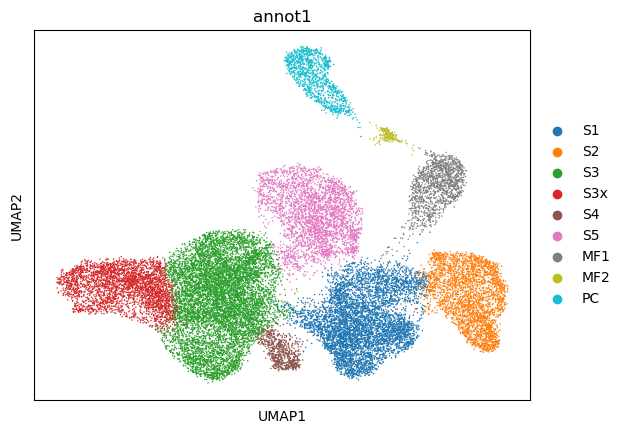

In [20]:
sc.pl.umap(adata, color='annot1', palette='tab10')

# scVelo

saving figure to file ./figures/scvelo_proportions_spliced_unspliced.pdf


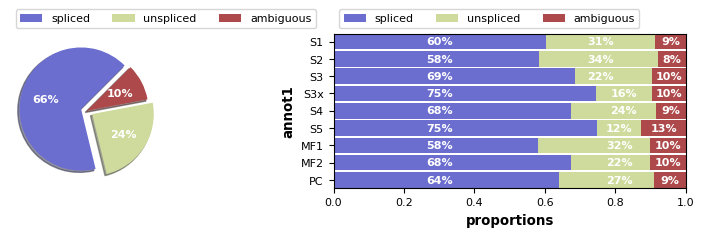

In [21]:
scv.pl.proportions(adata, groupby='annot1', save="spliced_unspliced.pdf")

In [22]:
#scv.pl.proportions(adata, groupby='sample_id')

In [23]:
# scVelocity

In [24]:
scv.pp.filter_and_normalize(adata, min_shared_counts=20, n_top_genes=2000)
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)

Filtered out 24301 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.
computing neighbors


/home/jovyan/my-conda-envs/ni_env2/lib/python3.10/site-packages/scvelo/preprocessing/utils.py:705: DeprecationWarning: `log1p` is deprecated since scVelo v0.3.0 and will be removed in a future version. Please use `log1p` from `scanpy.pp` instead.
  log1p(adata)


    finished (0:00:32) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:03) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


## Stochastic model

In [25]:
# Stochastic model
scv.tl.velocity(adata, mode="stochastic")


computing velocities
    finished (0:00:13) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


In [26]:
scv.tl.velocity_graph(adata)

computing velocity graph (using 1/26 cores)


  0%|          | 0/26727 [00:00<?, ?cells/s]

    finished (0:01:58) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [27]:
scv.set_figure_params(dpi_save=300)

computing velocity embedding
    finished (0:00:08) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_stochastic.svg


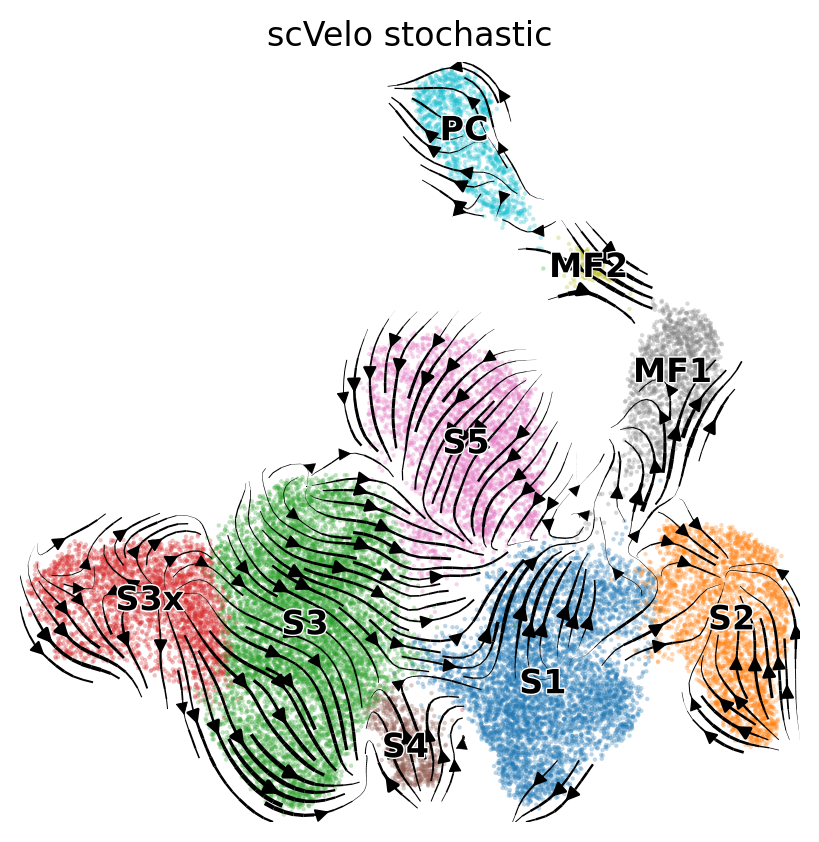

In [28]:
scv.pl.velocity_embedding_stream(
    adata,
    basis='umap',
    color='annot1',
    figsize=(5, 5),
    density=2.5,
    smooth=0.5,
    size=10,
    title='scVelo stochastic',
    #arrow_size=1,
    frameon=False,
    save="stochastic.svg"
)

## Deterministic model

In [29]:
# Deterministic model
scv.tl.velocity(adata, mode="deterministic")

computing velocities
    finished (0:00:02) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


In [30]:
scv.tl.velocity_graph(adata)

computing velocity graph (using 1/26 cores)


  0%|          | 0/26727 [00:00<?, ?cells/s]

    finished (0:01:30) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:08) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_deterministic.svg


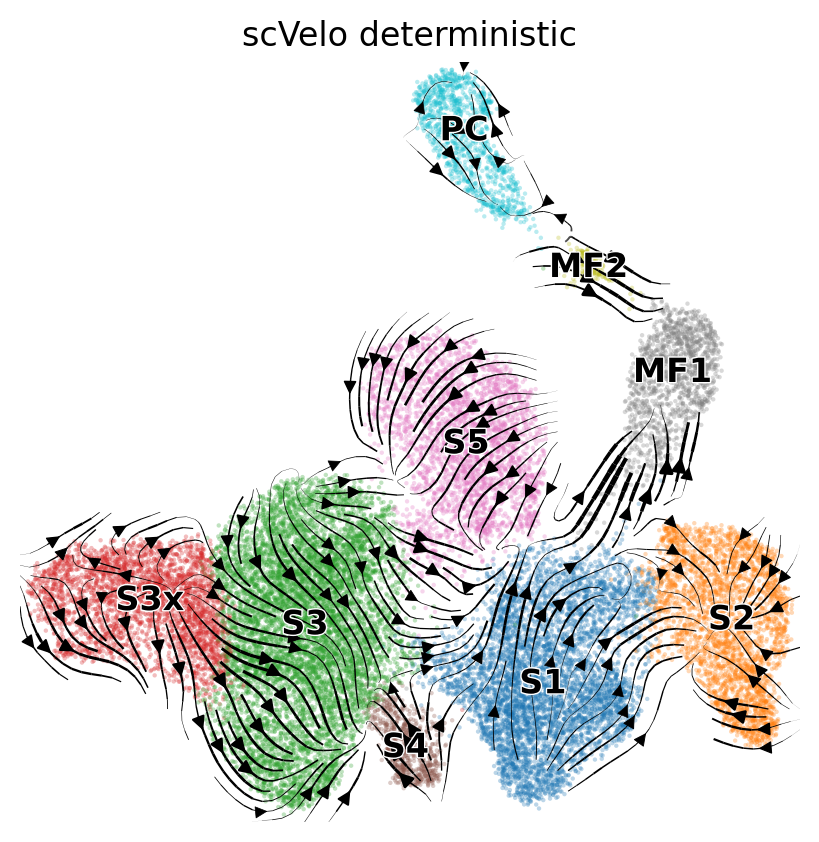

In [31]:
scv.pl.velocity_embedding_stream(
    adata,
    basis='umap',
    color='annot1',
    figsize=(5, 5),
    density=2.5,
    smooth=0.5,
    size=10,
    #arrow_size=1,
    title='scVelo deterministic',
    frameon=False,    
    save="deterministic.svg"
)

## Interpretation

saving figure to file ./figures/scvelo_velocity_S5_markers.pdf


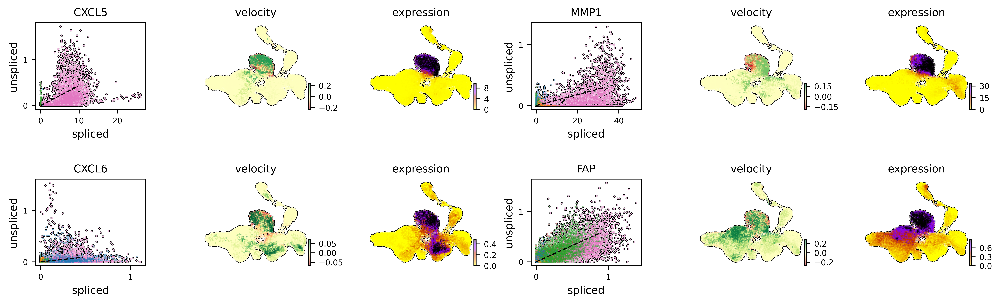

In [32]:
scv.pl.velocity(adata,
    ['CXCL5',  'MMP1', 'CXCL6', 'FAP', 'PDPN'],
    ncols=2,
    color='annot1',
    add_outline=True,
    figsize=(5, 4),
    save='velocity_S5_markers.pdf', dpi=300)

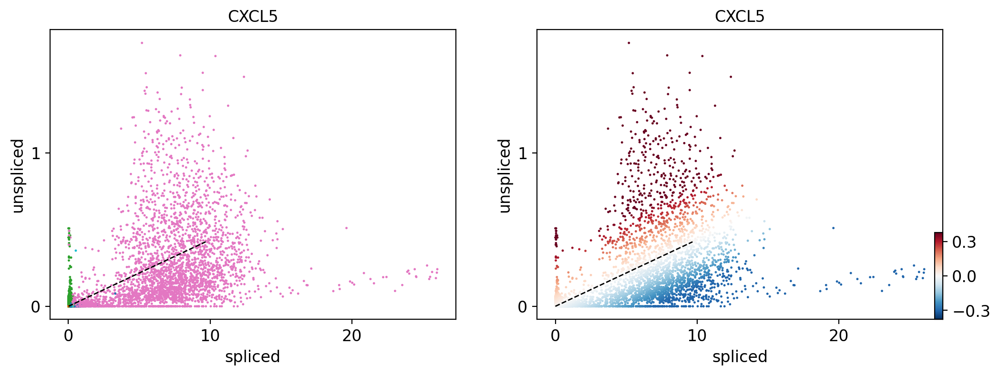

In [33]:
scv.pl.scatter(adata, 'CXCL5', color=['annot1', 'velocity'])

saving figure to file ./figures/scvelo_velocity_S5_TFs.pdf


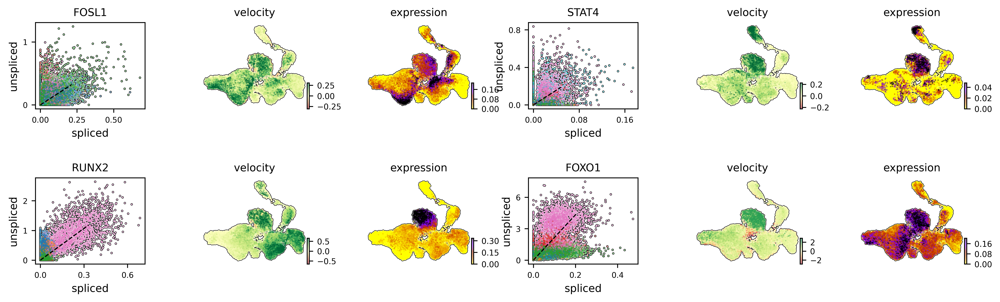

In [34]:
scv.pl.velocity(adata,
    ['ETV7', 'ELK1', 'ETV4', 'FOSL1', 'RELB', 'BATF3', 'ETS2', 'PRDM1', 'DRAP1', 'STAT4', 'RUNX2', 'CEBPB', 'FOXO1'],
    ncols=2,
    color='annot1',
    add_outline=True,
    figsize=(5, 4),
    save='velocity_S5_TFs.pdf', dpi=300)

In [35]:
# Speed and confidence
scv.tl.velocity_confidence(adata)

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)
--> added 'velocity_confidence_transition' (adata.obs)


saving figure to file ./figures/scvelo_speed_confidence.pdf


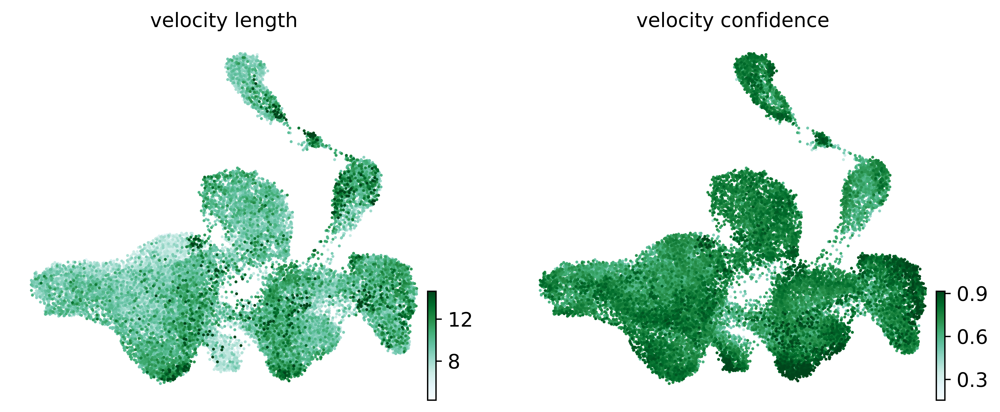

In [36]:
scv.pl.scatter(adata,
    c=['velocity_length', 'velocity_confidence'],
    #cmap='PuBuGn',
    #cmap='viridis',
    #cmap="Blues",
    cmap='BuGn',
    perc=[0, 99.5], figsize=(5, 4),
    save='speed_confidence.pdf', dpi=300
    )

## Dynamical model

In [37]:
# Dynamical model
scv.tl.recover_dynamics(adata, n_jobs=None)  # parallel implementation not working, runs in ~30m


recovering dynamics (using 1/26 cores)


  0%|          | 0/938 [00:00<?, ?gene/s]

    finished (0:31:04) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)


In [39]:
scv.tl.velocity(adata, mode="dynamical", diff_kinetics=True)

computing velocities
    finished (0:00:33) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


In [44]:
scv.tl.velocity_graph(adata)

computing velocity graph (using 1/26 cores)


  0%|          | 0/26727 [00:00<?, ?cells/s]

    finished (0:00:54) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [40]:
scv.tl.latent_time(adata)
scv.tl.velocity_pseudotime(adata)

computing terminal states
    identified 4 regions of root cells and 2 regions of end points .
    finished (0:00:08) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
computing latent time using root_cells as prior
    finished (0:00:10) --> added 
    'latent_time', shared time (adata.obs)


In [41]:
print("test")

test


In [43]:
adata

AnnData object with n_obs × n_vars = 26727 × 2000
    obs: 'n_counts_s', 'n_counts_u', 'n_counts_a', 'n_counts', 'sample_id', 'Sample', 'DOB', 'Gender', 'date', 'age_years', 'state', 'disease', 'site_taken_fine', 'site_taken_broad', 'sorted', 'Nancy_histologic_score', 'slide_look_other', 'whole_tissue_signature', 'doublet_bh_pval', 'scrublet_score', 'is_doublet', 'annot1', 'broad_annot1', 'annot_gut_lr', 'annot_gut_lr_prob', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'velocity_self_transition', 'velocity_length', 'velocity_confidence', 'velocity_confidence_transition', 'root_cells', 'end_points', 'velocity_pseudotime', 'latent_time'
    var: 'gene_ids', 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'velocity_gamma', 'velocity_qreg_ratio', 'velocity_r2', 'velocity_genes', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u

saving figure to file ./figures/scvelo_dynamical.svg


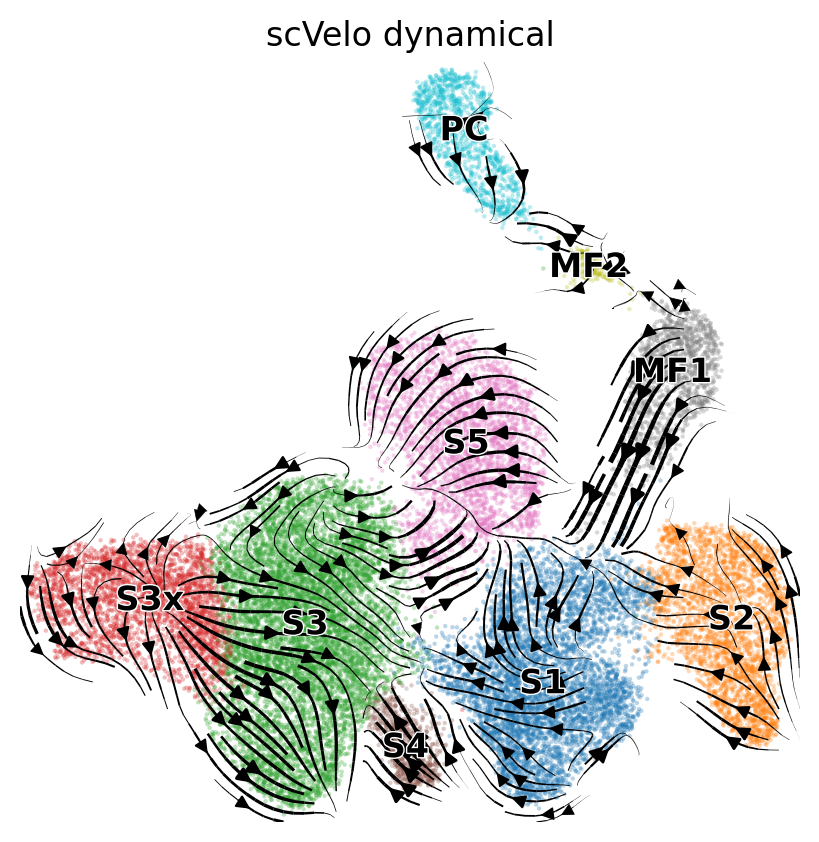

In [46]:
scv.pl.velocity_embedding_stream(
    adata,
    basis='umap',
    color='annot1',
    figsize=(5, 5),
    density=2.5,
    smooth=0.5,
    size=10,
    #arrow_size=1,
    title='scVelo dynamical',
    frameon=False,    
    save="dynamical.svg"
)

## Interpretation

/home/jovyan/my-conda-envs/ni_env2/lib/python3.10/site-packages/numpy/core/fromnumeric.py:57: DeprecationWarning: Passing `np.nan` to mean no clipping in np.clip has always been unreliable, and is now deprecated. In future, this will always return nan, like it already does when min or max are arrays that contain nan. To skip a bound, pass either None or an np.inf of an appropriate sign.
  return bound(*args, **kwds)


StopIteration: 

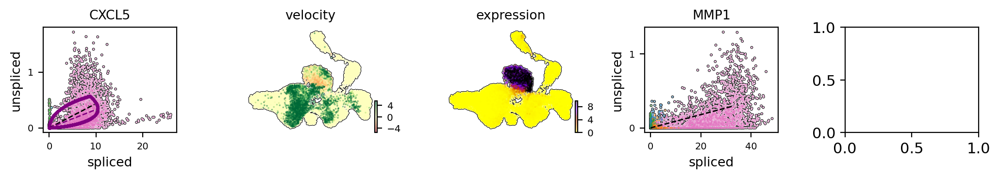

In [48]:
scv.pl.velocity(adata,
    ['CXCL5',  'MMP1', 'CXCL6', 'FAP', 'PDPN'],
    ncols=2,
    color='annot1',
    add_outline=True,
    figsize=(5, 4),
    #save='velocity_S5_markers.pdf', dpi=300
)

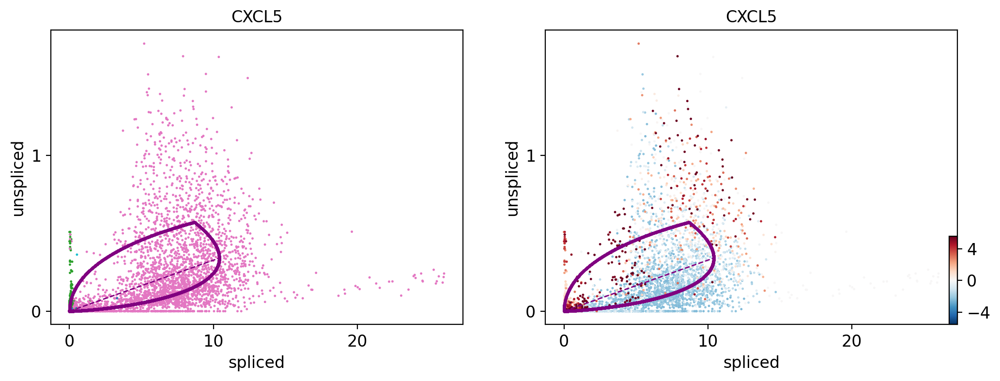

In [49]:
scv.pl.scatter(adata, 'CXCL5', color=['annot1', 'velocity'])

/home/jovyan/my-conda-envs/ni_env2/lib/python3.10/site-packages/numpy/core/fromnumeric.py:57: DeprecationWarning: Passing `np.nan` to mean no clipping in np.clip has always been unreliable, and is now deprecated. In future, this will always return nan, like it already does when min or max are arrays that contain nan. To skip a bound, pass either None or an np.inf of an appropriate sign.
  return bound(*args, **kwds)


StopIteration: 

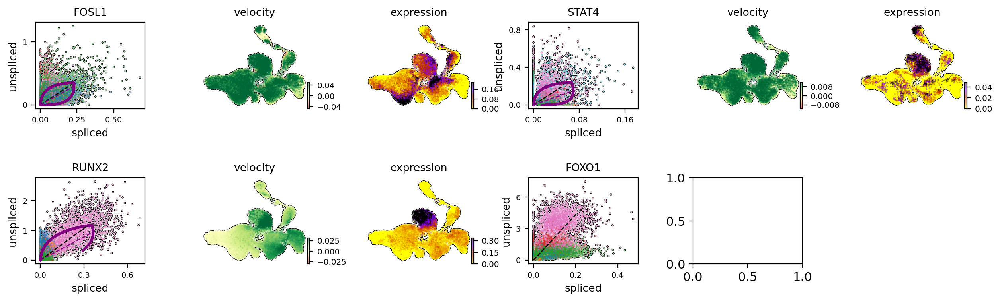

In [50]:
scv.pl.velocity(adata,
    ['ETV7', 'ELK1', 'ETV4', 'FOSL1', 'RELB', 'BATF3', 'ETS2', 'PRDM1', 'DRAP1', 'STAT4', 'RUNX2', 'CEBPB', 'FOXO1'],
    ncols=2,
    color='annot1',
    add_outline=True,
    figsize=(5, 4),
#    save='velocity_S5_TFs.pdf', dpi=300
)

In [51]:
# Speed and confidence
scv.tl.velocity_confidence(adata)

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)


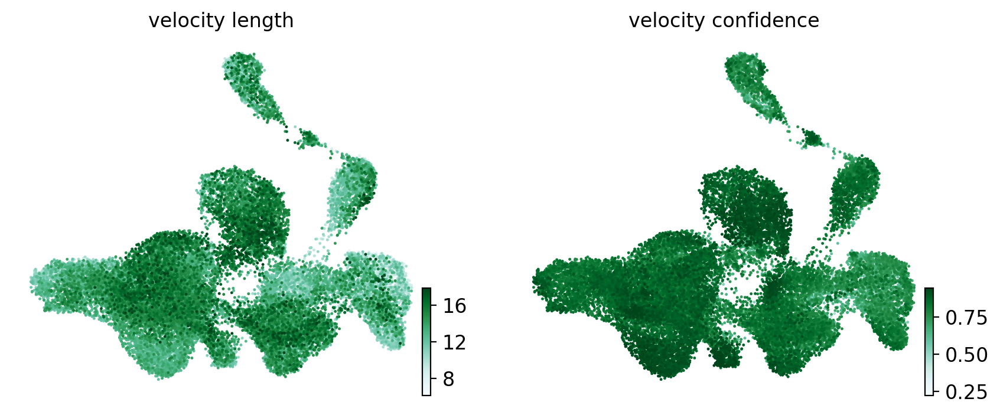

In [52]:
scv.pl.scatter(adata,
    c=['velocity_length', 'velocity_confidence'],
    #cmap='PuBuGn',
    #cmap='viridis',
    #cmap="Blues",
    cmap='BuGn',
    perc=[0, 99.5], figsize=(5, 4),
    #save='speed_confidence.pdf', dpi=300
)